In [1]:
using JLD, DataFrames, Statistics, Plots, FFTW, LaTeXStrings, Wavelets, EmpiricalOrthogonalFunctions

In [2]:
p_samples,  asm1_samples  = load(raw"/home/victor/Documents/code/asm1-simulator/data/sobol_clock.jld")
p_samples_redox,  asm1_samples_redox  = load(raw"/home/victor/Documents/code/asm1-simulator/data/sobol_redox.jld")
asm1_samples = asm1_samples[2];
asm1_samples_redox = asm1_samples_redox[2];

# <b> Fourier Transform <b>

### <i> Redox control

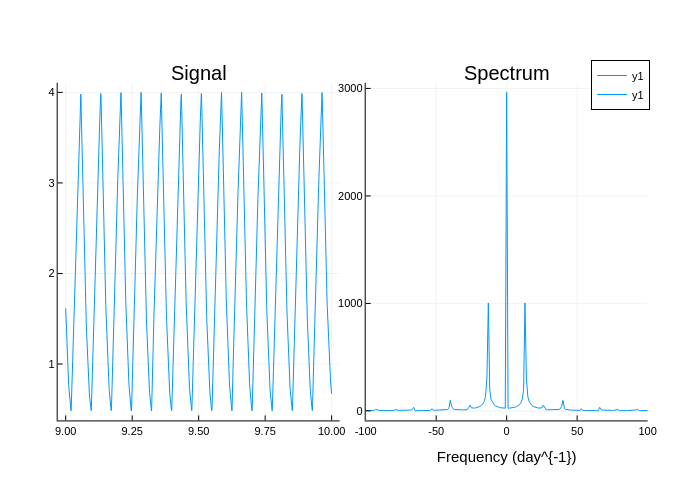

In [14]:
signal = asm1_samples_redox[93, 10, :];
t = collect(range(9, stop=10, length=Int((24*60))))
Ts = 1.0/(24*60)

F = fft(signal) |> fftshift
freqs = fftfreq(length(t), 1.0/Ts) |> fftshift
time_domain = plot(t, signal, title = "Signal")
freq_domain = plot(freqs, abs.(F), title = "Spectrum", xlim=(-100, +100), xlabel = "Frequency (day^{-1})")
plot(time_domain, freq_domain, layout = (1, 2), size = (1000, 400))

### <i> Clock Control

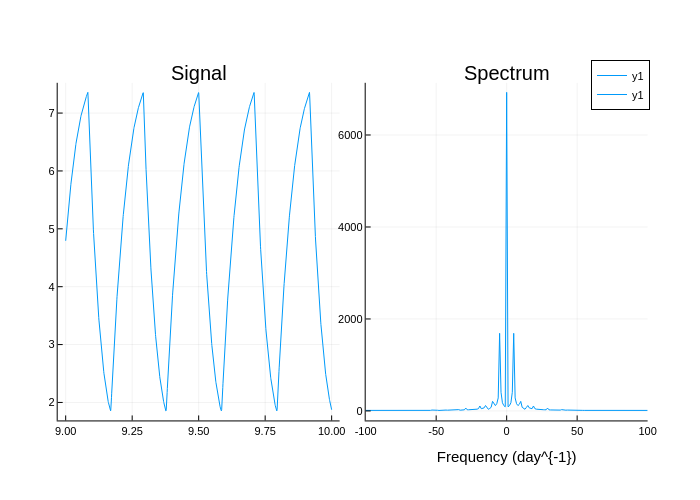

In [12]:
signal = asm1_samples[20, 10, :];
t = collect(range(9, stop=10, length=Int((24*60))))
Ts = 1.0/(24*60)

F = fft(signal) |> fftshift
freqs = fftfreq(length(t), 1.0/Ts) |> fftshift
time_domain = plot(t, signal, title = "Signal")
freq_domain = plot(freqs, abs.(F), title = "Spectrum", xlim=(-100, +100), xlabel = "Frequency (day^{-1})")
plot(time_domain, freq_domain, layout = (1, 2), size = (1000, 400))

# <b> Wavelet Transform <b>

### <i> Redox control

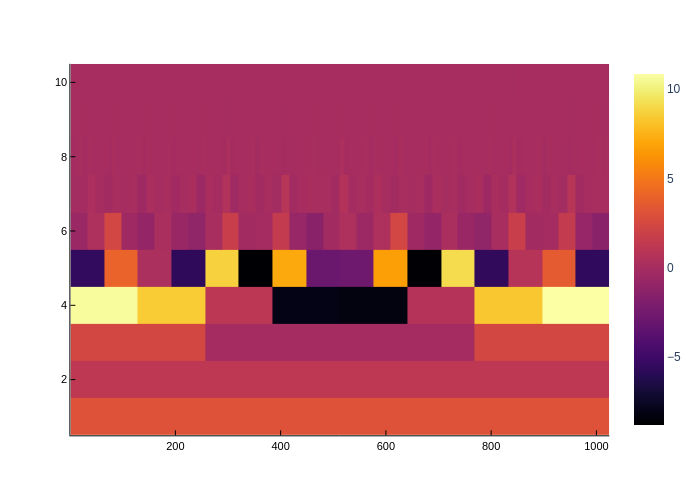

In [15]:
signal = asm1_samples_redox[93, 10, 1:1024];
t = collect(range(9, stop=10, length=Int((24*60))))

y = dwt(signal, wavelet(WT.cdf97, WT.Lifting))
time_domain = plot(t, signal, title = "Signal")
wavelet_domain = heatmap(wplotim(y))
# plot(time_domain, wavelet_domain, layout=(1, 2), size = (1000, 400))

### <i> Clock control

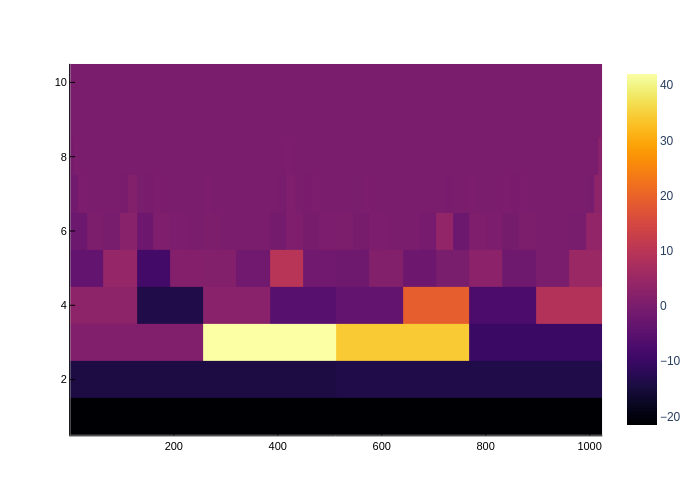

In [7]:
signal = asm1_samples[10, 10, 1:1024];
t = collect(range(9, stop=10, length=Int((24*60))))

y = dwt(signal, wavelet(WT.cdf97, WT.Lifting))
time_domain = plot(t, signal, title = "Signal")
wavelet_domain = heatmap(wplotim(y))
# plot(time_domain, wavelet_domain, layout=(1, 2), size = (1000, 400))

# Empirical Orthogonal Function

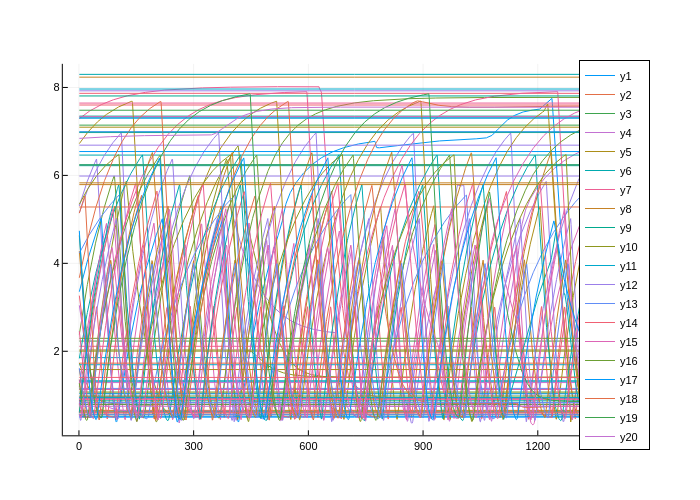

In [7]:
NH4 = asm1_samples_redox[:, 10, :]
plot(NH4[1:100,:]')

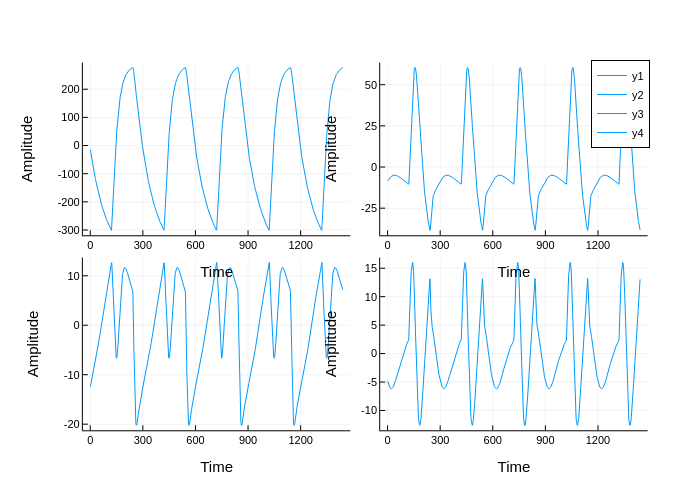

In [8]:
NH4 = asm1_samples[:, 10, :];
eof = EmpiricalOrthogonalFunction(NH4');
temporalsignal = pcs(eof);
plot(temporalsignal[:, 1:4], xlabel = "Time", ylabel = "Amplitude", size = (1000, 600), layout = (2, 2))

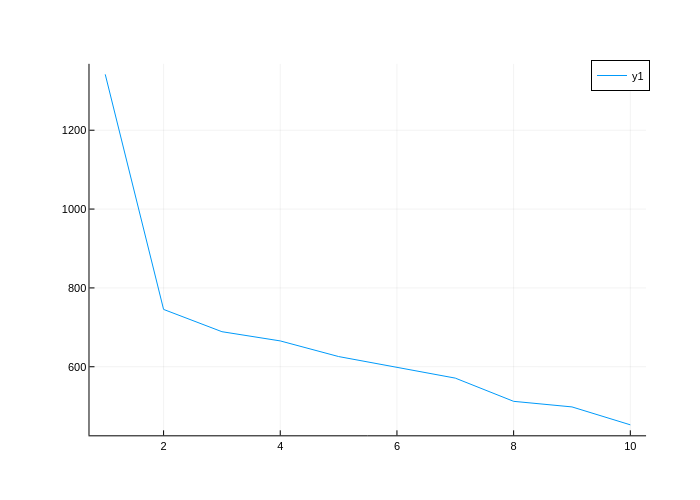

In [10]:
plot(eigenvalues(eof)[1:10])

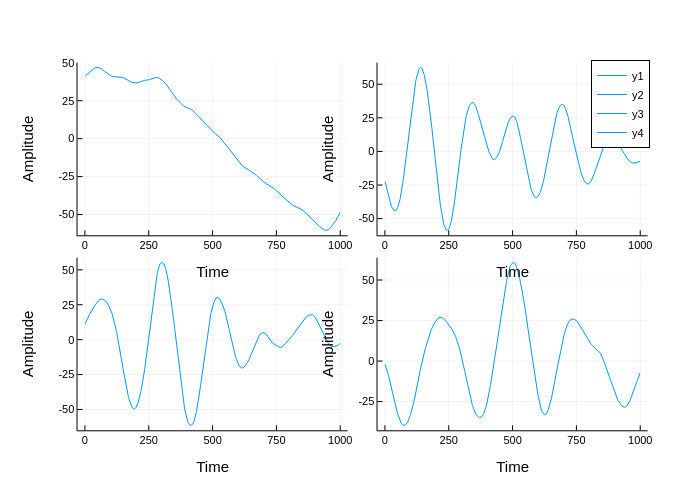

In [9]:
NH4 = asm1_samples_redox[:, 10, 1:999];
eof = EmpiricalOrthogonalFunction(NH4');
temporalsignal = pcs(eof);
plot(temporalsignal[:, 1:4], xlabel = "Time", ylabel = "Amplitude", size = (1000, 600), layout = (2, 2))

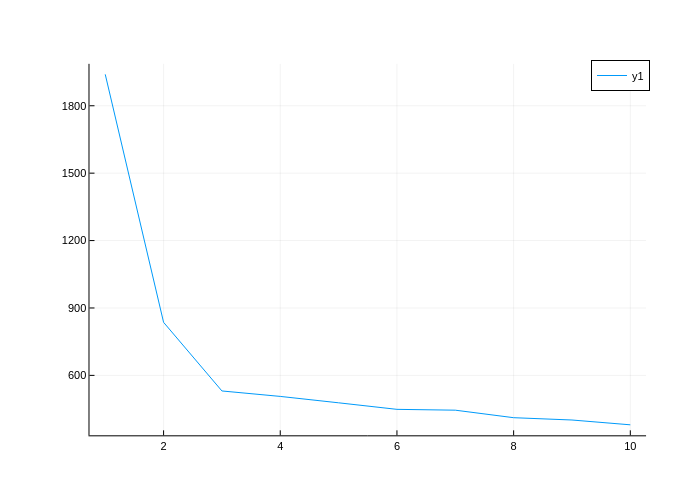

In [9]:
plot(eigenvalues(eof)[1:10])

In [75]:
teof = truncate(eof, 10)
reconstructed = reconstruct(teof);